In [1]:
import sys
sys.path.append("./Project2")
import helper

In [2]:
import pandas as pd
import numpy as np
import project_helper

## Market Data
### Load Data
While using real data will give you hands on experience, it's doesn't cover all the topics we try to condense in one project. We'll solve this by creating new stocks. We've create a scenario where companies mining [Terbium](https://en.wikipedia.org/wiki/Terbium) are making huge profits.

In [3]:
df_original = pd.read_csv('./Project2/eod-quotemedia.csv', parse_dates=['date'], index_col=False)
df_original.tail()

,date,ticker,adj_close,adj_high,adj_low
490732,2017-06-26,ZTS,62.430093,62.629169,61.952312
490733,2017-06-27,ZTS,62.469909,62.907875,62.330556
490734,2017-06-28,ZTS,62.659030,63.166673,62.320602
490735,2017-06-29,ZTS,62.211110,62.987505,61.763190
490736,2017-06-30,ZTS,62.091665,62.639123,62.081711


In [4]:
df = df_original
df = pd.concat([df] + project_helper.generate_tb_sector(df[df['ticker'] == 'AAPL']['date']), ignore_index=True)


df.tail()


C:\Users\Patrick\Anaconda3\envs\main\lib\site-packages\ipykernel_launcher.py:2: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.




,adj_close,adj_high,adj_low,adj_open,date,ticker
514948,2999.363014,3001.433117,2983.173833,3001.433117,2017-06-26,URUMIE
514949,3029.152663,3031.184091,3029.152663,3031.184091,2017-06-27,URUMIE
514950,3072.846464,3076.658823,3072.846464,3076.658823,2017-06-28,URUMIE
514951,3073.861248,3087.000868,3070.557421,3071.957062,2017-06-29,URUMIE
514952,3153.099000,3153.099000,3124.025793,3124.025793,2017-06-30,URUMIE


In [5]:
project_helper.generate_tb_sector(df[df['ticker'] == 'AAPL']['date'])

[      ticker       date     adj_open    adj_close     adj_high      adj_low
 3027  KAUFMA 2013-07-01     1.004146     0.999284     1.004146     0.999284
 3028  KAUFMA 2013-07-02     1.001915     1.006330     1.006330     1.001915
 3029  KAUFMA 2013-07-03     1.009050     1.010460     1.010460     1.009050
 3030  KAUFMA 2013-07-05     1.003411     1.003990     1.010148     1.003411
 3031  KAUFMA 2013-07-08     1.017696     1.011030     1.017696     1.010722
 3032  KAUFMA 2013-07-09     1.017257     1.021335     1.021335     1.017257
 3033  KAUFMA 2013-07-10     1.018891     1.022657     1.024466     1.018891
 3034  KAUFMA 2013-07-11     1.030196     1.022696     1.030196     1.022030
 3035  KAUFMA 2013-07-12     1.034083     1.035429     1.035429     1.027437
 3036  KAUFMA 2013-07-15     1.040931     1.043121     1.043121     1.040320
 3037  KAUFMA 2013-07-16     1.039864     1.037610     1.039864     1.037610
 3038  KAUFMA 2013-07-17     1.038153     1.040889     1.040889     1.038153

## extract the close, high low price into df

In [6]:
close = df.reset_index().pivot(index='date', columns='ticker', values='adj_close')
high = df.reset_index().pivot(index='date', columns='ticker', values='adj_high')
low = df.reset_index().pivot(index='date', columns='ticker', values='adj_low')


In [7]:
close.head()

ticker,A,AAL,AAP,AAPL,ABBV,ABC,ABT,ACN,ADBE,ADI,...,XL,XLNX,XOM,XRAY,XRX,XYL,YUM,ZBH,ZION,ZTS
date,,,,,,,,,,,,,,,,,,,,,
2013-07-01,29.994186,16.176093,81.138217,53.109173,34.924478,50.863198,31.425388,64.694095,46.235,39.913360,...,27.668791,35.288928,76.320802,40.023873,22.106665,25.753386,45.480383,71.898827,27.858587,29.447893
2013-07-02,29.650137,15.819834,80.722073,54.312247,35.428076,50.696766,31.272881,64.712041,46.030,39.860576,...,27.542284,35.059033,76.608168,39.965530,22.082740,25.613675,45.402661,72.934172,28.038932,28.572441
2013-07-03,29.705185,16.127950,81.237299,54.612043,35.444862,50.937167,30.725650,65.214519,46.420,40.186077,...,27.334452,35.280086,76.650427,40.004426,22.202365,25.734758,46.063299,72.301458,28.181310,28.168387
2013-07-05,30.434568,16.214608,81.821882,54.173381,35.856134,51.371737,31.326707,66.075911,47.000,40.652334,...,27.695899,35.801771,77.394196,40.675380,22.585164,26.060750,46.413048,73.164246,29.396267,29.024598
2013-07-08,30.524021,16.310894,82.951417,53.865799,36.661889,52.037461,31.766285,66.820655,46.625,40.256455,...,27.985057,35.200507,77.968926,40.646208,22.489464,26.228403,46.950626,73.892823,29.576612,29.765365


### Single Stock Example
Let's see what a single stock looks like from the closing prices. We'll use Apple's stock (AAPL).

In [9]:
apple_ticker = 'AAPL'
project_helper.plot_stock(close[apple_ticker], '{} Stock'.format(apple_ticker))

## The Alpha Research Process

In this project you will code and evaluate a "breakout" signal. It is important to understand where these steps fit in the alpha research workflow. The signal-to-noise ratio in trading signals is very low and, as such, it is very easy to fall into the trap of _overfitting_ to noise. It is therefore inadvisable to jump right into signal coding. To help mitigate overfitting, it is best to start with a general observation and hypothesis; i.e., you should be able to answer the following question _before_ you touch any data:

> What feature of markets or investor behaviour would lead to a persistent anomaly that my signal will try to use?

Ideally the assumptions behind the hypothesis will be testable _before_ you actually code and evaluate the signal itself. The workflow therefore is as follows:

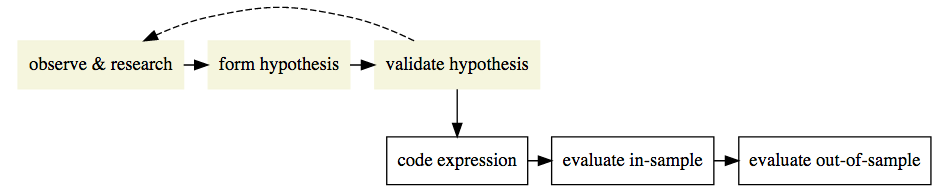

In this project, we assume that the first three steps area done ("observe & research", "form hypothesis", "validate hypothesis"). The hypothesis you'll be using for this project is the following:
- In the absence of news or significant investor trading interest, stocks oscillate in a range.
- Traders seek to capitalize on this range-bound behaviour periodically by selling/shorting at the top of the range and buying/covering at the bottom of the range. This behaviour reinforces the existence of the range.
- When stocks break out of the range, due to, e.g., a significant news release or from market pressure from a large investor:
    - the liquidity traders who have been providing liquidity at the bounds of the range seek to cover their positions to mitigate losses, thus magnifying the move out of the range, _and_
    - the move out of the range attracts other investor interest; these investors, due to the behavioural bias of _herding_ (e.g., [Herd Behavior](https://www.investopedia.com/university/behavioral_finance/behavioral8.asp)) build positions which favor continuation of the trend.

## Compute the threshold by using max/min price in rolling window period
- use the price highs and lows as an indicator for the breakout strategy.
- get the maximum high price and minimum low price over a window of days.
- Make sure this doesn't include the current day.

In [10]:
def get_high_lows_lookback(high, low, lookback_days):
    lb_high = high.shift(1).rolling(window=lookback_days).max()
    
    lb_low = low.shift(1).rolling(window=lookback_days).min()
    return lb_high, lb_low

In [11]:
high.tail()

ticker,A,AAL,AAP,AAPL,ABBV,ABC,ABT,ACN,ADBE,ADI,...,XL,XLNX,XOM,XRAY,XRX,XYL,YUM,ZBH,ZION,ZTS
date,,,,,,,,,,,,,,,,,,,,,
2017-06-26,59.280617,49.353786,124.345355,145.994797,70.553488,95.027661,48.481700,121.769577,146.89,80.425571,...,42.871876,66.613120,78.615884,63.656033,28.059959,54.215677,74.197462,128.726240,42.011956,62.629169
2017-06-27,58.904860,49.130713,123.028264,143.907469,70.664718,95.008011,48.167966,120.581821,144.81,78.907184,...,43.371926,65.897904,78.596651,64.489435,28.155727,54.195905,73.720612,128.022222,42.485330,62.907875
2017-06-28,59.033409,49.369253,120.334215,143.858240,71.128981,95.410837,48.060120,121.553621,144.08,77.770842,...,43.440560,64.751598,78.625500,65.072653,28.453997,54.403514,73.233828,128.329610,42.889671,63.166673
2017-06-29,59.096559,49.259599,117.989394,142.893343,70.771112,96.137889,48.236595,121.229688,143.20,77.506348,...,43.710194,64.243696,78.702433,65.013044,28.357411,54.818733,72.909306,127.863570,44.230898,62.987505
2017-06-30,59.037096,50.077536,117.560341,142.725963,70.432587,93.563732,48.084630,122.113143,142.81,76.732460,...,43.504292,63.448532,78.126398,64.625589,28.338094,55.046115,72.919140,127.833822,43.599732,62.639123


In [12]:
high.shift(1).tail()


ticker,A,AAL,AAP,AAPL,ABBV,ABC,ABT,ACN,ADBE,ADI,...,XL,XLNX,XOM,XRAY,XRX,XYL,YUM,ZBH,ZION,ZTS
date,,,,,,,,,,,,,,,,,,,,,
2017-06-26,59.913471,48.679608,121.162385,144.892058,71.080621,95.115103,48.393462,121.347482,145.59,80.463776,...,42.710096,66.231018,78.558184,63.497290,27.274663,53.909207,74.099221,128.557672,42.248643,63.226396
2017-06-27,59.280617,49.353786,124.345355,145.994797,70.553488,95.027661,48.481700,121.769577,146.89,80.425571,...,42.871876,66.613120,78.615884,63.656033,28.059959,54.215677,74.197462,128.726240,42.011956,62.629169
2017-06-28,58.904860,49.130713,123.028264,143.907469,70.664718,95.008011,48.167966,120.581821,144.81,78.907184,...,43.371926,65.897904,78.596651,64.489435,28.155727,54.195905,73.720612,128.022222,42.485330,62.907875
2017-06-29,59.033409,49.369253,120.334215,143.858240,71.128981,95.410837,48.060120,121.553621,144.08,77.770842,...,43.440560,64.751598,78.625500,65.072653,28.453997,54.403514,73.233828,128.329610,42.889671,63.166673
2017-06-30,59.096559,49.259599,117.989394,142.893343,70.771112,96.137889,48.236595,121.229688,143.20,77.506348,...,43.710194,64.243696,78.702433,65.013044,28.357411,54.818733,72.909306,127.863570,44.230898,62.987505


### View Data
Let's use your implementation of `get_high_lows_lookback` to get the highs and lows for the past 50 days and compare it to it their respective stock.

In [13]:
lookback_days = 50

lookback_high, lookback_low = get_high_lows_lookback(high, low, lookback_days)
project_helper.plot_high_low(
    close[apple_ticker],
    lookback_high[apple_ticker],
    lookback_low[apple_ticker],
    'High and Low of {} Stock'.format(apple_ticker))

In [14]:
lookback_high


ticker,A,AAL,AAP,AAPL,ABBV,ABC,ABT,ACN,ADBE,ADI,...,XL,XLNX,XOM,XRAY,XRX,XYL,YUM,ZBH,ZION,ZTS
date,,,,,,,,,,,,,,,,,,,,,
2013-07-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-07-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-07-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-07-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-07-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-07-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-07-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-07-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-07-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Get Long and Short Signals by using the threshold
Using the generated indicator of highs and lows, create long and short signals using a breakout strategy. Implement `get_long_short` to generate the following signals:

| Signal | Condition |
|----|------|
| -1 | Low > Close Price |
| 1  | High < Close Price |
| 0  | Otherwise |

In this chart, **Close Price** is the `close` parameter. **Low** and **High** are the values generated from `get_high_lows_lookback`, the `lookback_high` and `lookback_low` parameters.

- 0= do nothing signal
- 1= long signal
- -1= short signal

In [15]:
def get_long_short(close, lookback_high, lookback_low):

    short = (close < lookback_low).astype(np.int) * -1

    long = (close > lookback_high).astype(np.int)
    
    ls = short + long   

    return ls

### View Data
Let's compare the signals you generated against the close prices. This chart will show a lot of signals. Too many in fact.

In [16]:
signal = get_long_short(close, lookback_high, lookback_low)
project_helper.plot_signal(
    close[apple_ticker],
    signal[apple_ticker],
    'Long and Short of {} Stock'.format(apple_ticker))

In [17]:
signal.tail()

ticker,A,AAL,AAP,AAPL,ABBV,ABC,ABT,ACN,ADBE,ADI,...,XL,XLNX,XOM,XRAY,XRX,XYL,YUM,ZBH,ZION,ZTS
date,,,,,,,,,,,,,,,,,,,,,
2017-06-26,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,1,0,0,0,0
2017-06-27,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2017-06-28,0,0,-1,0,0,0,0,0,0,0,...,0,0,0,0,1,1,0,0,0,0
2017-06-29,0,0,-1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
2017-06-30,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


## Filter the long/short signals 
- That are a lot of repeated signals. For example if the stock is lower/higher than threshold signal for consecutive days, will get consecutive 1 or -1 in the signal df.
- we're already short/long a stock, having an additional signal isn't helpful therefore we want to filer out the repeated signals.
- If the previous signal was the same, change the signal to `0` (do nothing signal). For example, say you have a single stock time series that is

In [18]:
def clear_signals(signals, window_size):


    clean_signals = [0]*window_size
    
    for signal_i, current_signal in enumerate(signals):
                

        has_past_signal = bool(sum(clean_signals[signal_i:signal_i+window_size]))

        clean_signals.append(not has_past_signal and current_signal)


    clean_signals = clean_signals[window_size:]

    return pd.Series(np.array(clean_signals).astype(np.int), signals.index)


def filter_signals(signal, lookahead_days):

    filtered_signal = signal.copy()
    
    long_signals = np.floor((signal + 1) / 2).astype(np.int)

    
    short_signals = np.ceil((signal - 1) / 2).astype(np.int)
    
    for ticker, series in signal.iteritems():
        cleared_long_signals = clear_signals(long_signals.loc[:,ticker], lookahead_days)

        
        cleared_short_signals = clear_signals(short_signals.loc[:,ticker], lookahead_days)
        
        filtered_signal.loc[:,ticker] = cleared_long_signals + cleared_short_signals
    
    return filtered_signal

signal_5 = filter_signals(signal, 5)
signal_5

ticker,A,AAL,AAP,AAPL,ABBV,ABC,ABT,ACN,ADBE,ADI,...,XL,XLNX,XOM,XRAY,XRX,XYL,YUM,ZBH,ZION,ZTS
date,,,,,,,,,,,,,,,,,,,,,
2013-07-01,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2013-07-02,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2013-07-03,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2013-07-05,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2013-07-08,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2013-07-09,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2013-07-10,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2013-07-11,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2013-07-12,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [19]:
signal_5 = filter_signals(signal, 5)
signal_10 = filter_signals(signal, 10)
signal_20 = filter_signals(signal, 20)
for signal_data, signal_days in [(signal_5, 5), (signal_10, 10), (signal_20, 20)]:
    project_helper.plot_signal(
        close[apple_ticker],
        signal_data[apple_ticker],
        'Long and Short of {} Stock with {} day signal window'.format(apple_ticker, signal_days))

## Lookahead Close Prices


In [32]:
def get_lookahead_prices(close, lookahead_days):
    return close.shift(-1*lookahead_days)



### View Data
Using the `get_lookahead_prices` function, let's generate lookahead closing prices for 5, 10, and 20 days.

Let's also chart a subsection of a few months of the Apple stock instead of years. This will allow you to view the differences between the 5, 10, and 20 day lookaheads. Otherwise, they will mesh together when looking at a chart that is zoomed out.

In [33]:
lookahead_5 = get_lookahead_prices(close, 5)
lookahead_10 = get_lookahead_prices(close, 10)
lookahead_20 = get_lookahead_prices(close, 20)
project_helper.plot_lookahead_prices(
    close[apple_ticker].iloc[150:250],
    [
        (lookahead_5[apple_ticker].iloc[150:250], 5),
        (lookahead_10[apple_ticker].iloc[150:250], 10),
        (lookahead_20[apple_ticker].iloc[150:250], 20)],
    '5, 10, and 20 day Lookahead Prices for Slice of {} Stock'.format(apple_ticker))

## take log of the Lookahead Price Returns
Implement `get_return_lookahead` to generate the log price return between the closing price and the lookahead price.

In [34]:
def get_return_lookahead(close, lookahead_prices):
    return np.log(lookahead_prices) - np.log(close)

### View Data
Using the same lookahead prices and same subsection of the Apple stock from the previous problem, we'll view the lookahead returns.

In order to view price returns on the same chart as the stock, a second y-axis will be added. When viewing this chart, the axis for the price of the stock will be on the left side, like previous charts. The axis for price returns will be located on the right side.

In [35]:
price_return_5 = get_return_lookahead(close, lookahead_5)
price_return_10 = get_return_lookahead(close, lookahead_10)
price_return_20 = get_return_lookahead(close, lookahead_20)
project_helper.plot_price_returns(
    close[apple_ticker].iloc[150:250],
    [
        (price_return_5[apple_ticker].iloc[150:250], 5),
        (price_return_10[apple_ticker].iloc[150:250], 10),
        (price_return_20[apple_ticker].iloc[150:250], 20)],
    '5, 10, and 20 day Lookahead Returns for Slice {} Stock'.format(apple_ticker))

C:\Users\Patrick\Anaconda3\envs\main\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning:

invalid value encountered in log



## Compute the Signal Return

In [36]:
def get_signal_return(signal, lookahead_returns):
    return signal * lookahead_returns  

### View Data
Let's continue using the previous lookahead prices to view the signal returns. Just like before, the axis for the signal returns is on the right side of the chart.

In [37]:
title_string = '{} day LookaheadSignal Returns for {} Stock'
signal_return_5 = get_signal_return(signal_5, price_return_5)
signal_return_10 = get_signal_return(signal_10, price_return_10)
signal_return_20 = get_signal_return(signal_20, price_return_20)
project_helper.plot_signal_returns(
    close[apple_ticker],
    [
        (signal_return_5[apple_ticker], signal_5[apple_ticker], 5),
        (signal_return_10[apple_ticker], signal_10[apple_ticker], 10),
        (signal_return_20[apple_ticker], signal_20[apple_ticker], 20)],
    [title_string.format(5, apple_ticker), title_string.format(10, apple_ticker), title_string.format(20, apple_ticker)])

## Test for Significance
### Histogram
Let's plot a histogram of the signal return values.

In [38]:
project_helper.plot_signal_histograms(
    [signal_return_5, signal_return_10, signal_return_20],
    'Signal Return',
    ('5 Days', '10 Days', '20 Days'))

## Outliers
You might have noticed the outliers in the 10 and 20 day histograms. To better visualize the outliers, let's compare the 5, 10, and 20 day signals returns to normal distributions with the same mean and deviation for each signal return distributions.

In [39]:
project_helper.plot_signal_to_normal_histograms(
    [signal_return_5, signal_return_10, signal_return_20],
    'Signal Return',
    ('5 Days', '10 Days', '20 Days'))

## Use Kolmogorov-Smirnov(KS) Test to find outlier
- find the stocks that are causing these outlying returns. 
- This test will be applied to teach ticker's signal returns where a long or short signal exits.

### First get the correct data format

In [40]:
long_short_signal_returns_5 = signal_return_5[signal_5 != 0].stack()

long_short_signal_returns_10 = signal_return_10[signal_10 != 0].stack()
long_short_signal_returns_20 = signal_return_20[signal_20 != 0].stack()

In [41]:
signal_5 != 0

ticker,A,AAL,AAP,AAPL,ABBV,ABC,ABT,ACN,ADBE,ADI,...,XL,XLNX,XOM,XRAY,XRX,XYL,YUM,ZBH,ZION,ZTS
date,,,,,,,,,,,,,,,,,,,,,
2013-07-01,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2013-07-02,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2013-07-03,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2013-07-05,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2013-07-08,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2013-07-09,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2013-07-10,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2013-07-11,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2013-07-12,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [42]:
signal_return_5[signal_5 != 0]

ticker,A,AAL,AAP,AAPL,ABBV,ABC,ABT,ACN,ADBE,ADI,...,XL,XLNX,XOM,XRAY,XRX,XYL,YUM,ZBH,ZION,ZTS
date,,,,,,,,,,,,,,,,,,,,,
2013-07-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-07-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-07-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-07-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-07-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-07-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-07-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-07-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-07-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [43]:
long_short_signal_returns_5 = signal_return_5[signal_5 != 0].stack()
signal_return_5[signal_5 != 0].stack()


date        ticker
2013-09-11  A         0.007326
            ABC       0.016396
            ADP       0.009815
            AKAM      0.044005
            ALGN      0.015456
            APC       0.003059
            BA        0.080613
            BAKERI    0.031432
            BCR       0.009334
            BIIB      0.041762
            CHK       0.015132
            CI       -0.012840
            CLUSIA    0.018735
            CMG       0.006473
            COP       0.020041
            CTSH      0.045673
            CXO       0.026219
            DHR       0.016882
            ECL       0.032131
            ED       -0.035543
            EL        0.034968
            EOG       0.027381
            EXPD      0.010893
            FB        0.004210
            FCX       0.051065
            FLR       0.040280
            FMC       0.012854
            GRMN      0.044667
            GWW       0.015891
            HRS       0.001542
                        ...   
2017-06-22  HUM     

In [44]:
long_short_signal_returns_5.reset_index()

,date,ticker,0
0,2013-09-11,A,0.007326
1,2013-09-11,ABC,0.016396
2,2013-09-11,ADP,0.009815
3,2013-09-11,AKAM,0.044005
4,2013-09-11,ALGN,0.015456
5,2013-09-11,APC,0.003059
6,2013-09-11,BA,0.080613
7,2013-09-11,BAKERI,0.031432
8,2013-09-11,BCR,0.009334
9,2013-09-11,BIIB,0.041762


In [45]:
long_short_signal_returns_5.reset_index().iloc[:, [1,2]]

,ticker,0
0,A,0.007326
1,ABC,0.016396
2,ADP,0.009815
3,AKAM,0.044005
4,ALGN,0.015456
5,APC,0.003059
6,BA,0.080613
7,BAKERI,0.031432
8,BCR,0.009334
9,BIIB,0.041762


In [46]:
long_short_signal_returns_5 = long_short_signal_returns_5.reset_index().iloc[:, [1,2]]


long_short_signal_returns_5.columns = ['ticker', 'signal_return']
long_short_signal_returns_10 = long_short_signal_returns_10.reset_index().iloc[:, [1,2]]
long_short_signal_returns_10.columns = ['ticker', 'signal_return']
long_short_signal_returns_20 = long_short_signal_returns_20.reset_index().iloc[:, [1,2]]
long_short_signal_returns_20.columns = ['ticker', 'signal_return']

long_short_signal_returns_5.head(10)

,ticker,signal_return
0,A,0.007326
1,ABC,0.016396
2,ADP,0.009815
3,AKAM,0.044005
4,ALGN,0.015456
5,APC,0.003059
6,BA,0.080613
7,BAKERI,0.031432
8,BCR,0.009334
9,BIIB,0.041762


This gives you the data to use in the KS-Test.

Now it's time to implement the function `calculate_kstest` to use Kolmogorov-Smirnov test (KS test) between a normal distribution and each stock's signal returns. Run KS test on a normal distribution against each stock's signal returns. Use [`scipy.stats.kstest`](https://docs.scipy.org/doc/scipy-0.14.0/reference/generated/scipy.stats.kstest.html#scipy-stats-kstest) perform the KS test. When calculating the standard deviation of the signal returns, make sure to set the delta degrees of freedom to 0.

For this function, we don't reccommend you try to find a vectorized solution. Instead, you should iterate over the [`groupby`](https://pandas.pydata.org/pandas-docs/version/0.21/generated/pandas.DataFrame.groupby.html) function.

In [47]:
from scipy.stats import kstest


def calculate_kstest(long_short_signal_returns):
    normal_args = (np.mean(long_short_signal_returns.loc[:,'signal_return']), 
                   np.std(long_short_signal_returns.loc[:,'signal_return'], ddof=0))
    #get the mean and sd 
    
    ks_values = pd.Series()
    p_values = pd.Series()
    
    for i in np.unique(long_short_signal_returns.ticker):

        
        single_stock = long_short_signal_returns[long_short_signal_returns.ticker == i]
        
        ks_values[i], p_values[i] = kstest(single_stock["signal_return"].values, 
                                                     'norm', 
                                                     normal_args)

    return ks_values, p_values

In [48]:
long_short_signal_returns_5[long_short_signal_returns_5.ticker=="ABC"]

,ticker,signal_return
1,ABC,0.016396
204,ABC,-0.017344
322,ABC,-0.020863
478,ABC,0.030806
807,ABC,0.017323
977,ABC,0.015089
1130,ABC,0.015723
1394,ABC,0.002128
2317,ABC,0.000446
2479,ABC,-0.018246


### View Data
Using the signal returns we created above, let's calculate the ks and p values.

In [51]:
ks_values_5, p_values_5 = calculate_kstest(long_short_signal_returns_5)
ks_values_10, p_values_10 = calculate_kstest(long_short_signal_returns_10)
ks_values_20, p_values_20 = calculate_kstest(long_short_signal_returns_20)

print('ks_values_5')
print(ks_values_5.head(10))
print('p_values_5')
print(p_values_5.head(10))

ks_values_5
A       0.172149
AAL     0.107434
AAP     0.196973
AAPL    0.155653
ABBV    0.168184
ABC     0.214135
ABT     0.213751
ACN     0.282257
ADBE    0.242723
ADI     0.194340
dtype: float64
p_values_5
A       0.187065
AAL     0.724502
AAP     0.045004
AAPL    0.247158
ABBV    0.246724
ABC     0.027314
ABT     0.048266
ACN     0.005846
ADBE    0.009107
ADI     0.098730
dtype: float64


## Find Outliers
With the ks and p values calculate, let's find which symbols are the outliers. Implement the `find_outliers` function to find the following outliers:
- Symbols that pass the null hypothesis with a p-value less than `pvalue_threshold`.
- Symbols that with a KS value above `ks_threshold`.

In [52]:
def find_outliers(ks_values, p_values, ks_threshold, pvalue_threshold=0.05):
  
    ks_value_outliers = ks_values > ks_threshold
    p_value_outliers = p_values < pvalue_threshold
    
    ks_and_p_value_outliers = (ks_value_outliers & p_value_outliers).where(lambda x: x == True).dropna()
    
    
    outliers = set(ks_and_p_value_outliers.index.values)

    return outliers

### View Data
Using the `find_outliers` function you implemented, let's see what we found.

In [58]:
ks_threshold = 0.8
outliers_5 = find_outliers(ks_values_5, p_values_5, ks_threshold)
outliers_10 = find_outliers(ks_values_10, p_values_10, ks_threshold)
outliers_20 = find_outliers(ks_values_20, p_values_20, ks_threshold)

outlier_tickers = outliers_5.union(outliers_10).union(outliers_20)
print('{} Outliers Found:\n{}'.format(len(outlier_tickers), ', '.join(list(outlier_tickers))))

24 Outliers Found:
LINIFO, PRAEST, CLUSIA, KAUFMA, ARMENA, GESNER, GREIGI, BAKERI, HUMILI, TURKES, TARDA, PULCHE, VVEDEN, KOLPAK, BIFLOR, SAXATI, ALTAIC, SYLVES, ORPHAN, AGENEN, URUMIE, SCHREN, SPRENG, DASYST


### Show Significance without Outliers
Let's compare the 5, 10, and 20 day signals returns without outliers to normal distributions. Also, let's see how the P-Value has changed with the outliers removed.

In [59]:
good_tickers = list(set(close.columns) - outlier_tickers)

project_helper.plot_signal_to_normal_histograms(
    [signal_return_5[good_tickers], signal_return_10[good_tickers], signal_return_20[good_tickers]],
    'Signal Return Without Outliers',
    ('5 Days', '10 Days', '20 Days'))